In [0]:
!pip install kaggle

In [0]:
!rm -r .kaggle
!ls
!mkdir .kaggle
!ls

rm: cannot remove '.kaggle': No such file or directory
sample_data
sample_data


In [0]:
import json
token = {"username":"hrishabhdigaari","key":"ca837c7d1f74b95b820da02fec372f17"}
with open('/content/.kaggle/kaggle.json', 'w') as file:
    json.dump(token, file)

In [0]:
!cp /content/.kaggle/kaggle.json ~/.kaggle/kaggle.json

In [0]:
!kaggle config set -n path -v{/content}

- path is now set to: {/content}


In [0]:
!chmod 600 /root/.kaggle/kaggle.json

In [0]:
!kaggle datasets list

ref                                                             title                                                size  lastUpdated          downloadCount  
--------------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  
allen-institute-for-ai/CORD-19-research-challenge               COVID-19 Open Research Dataset Challenge (CORD-19)    3GB  2020-06-10 00:09:23          71785  
roche-data-science-coalition/uncover                            UNCOVER COVID-19 Challenge                          179MB  2020-05-21 18:57:53          10483  
kwullum/fatal-police-shootings-in-the-us                        Fatal Police Shootings in the US                      1MB  2017-09-22 19:18:21          12617  
Cornell-University/arxiv                                        ArXiv Metadata                                        2GB  2020-05-06 23:18:35              2  
longnguyen2306/bacteria-detection-with-d

In [0]:
!kaggle datasets download -d hrishabhdigaari/casia-b-gei

 93% 41.0M/44.2M [00:02<00:00, 19.0MB/s]
100% 44.2M/44.2M [00:02<00:00, 17.7MB/s]


In [0]:
!unzip /content/{/content}/datasets/hrishabhdigaari/casia-b-gei/casia-b-gei.zip

Streaming output truncated to the last 5000 lines.
  inflating: gei3/014-nm-03-108-220.jpg_new.jpg  
  inflating: gei3/014-nm-03-126-221.jpg_new.jpg  
  inflating: gei3/014-nm-03-126-222.jpg_new.jpg  
  inflating: gei3/014-nm-03-126-223.jpg_new.jpg  
  inflating: gei3/014-nm-03-144-224.jpg_new.jpg  
  inflating: gei3/014-nm-03-144-225.jpg_new.jpg  
  inflating: gei3/014-nm-03-144-226.jpg_new.jpg  
  inflating: gei3/014-nm-03-162-227.jpg_new.jpg  
  inflating: gei3/014-nm-03-162-228.jpg_new.jpg  
  inflating: gei3/014-nm-03-162-229.jpg_new.jpg  
  inflating: gei3/014-nm-03-180-230.jpg_new.jpg  
  inflating: gei3/014-nm-03-180-231.jpg_new.jpg  
  inflating: gei3/014-nm-03-180-232.jpg_new.jpg  
  inflating: gei3/014-nm-04-000-233.jpg_new.jpg  
  inflating: gei3/014-nm-04-000-234.jpg_new.jpg  
  inflating: gei3/014-nm-04-000-235.jpg_new.jpg  
  inflating: gei3/014-nm-04-000-236.jpg_new.jpg  
  inflating: gei3/014-nm-04-018-237.jpg_new.jpg  
  inflating: gei3/014-nm-04-018-238.jpg_new.jpg  

In [0]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
import os
import time
import tensorflow as tf
import numpy as np
from glob import glob
import datetime
import random
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline

In [0]:
def generator(z, output_channel_dim, training):
    with tf.variable_scope("generator", reuse= not training):
        
        # 8x8x1024
        fully_connected = tf.layers.dense(z, 8*8*1024)
        fully_connected = tf.reshape(fully_connected, (-1, 8, 8, 1024))
        fully_connected = tf.nn.leaky_relu(fully_connected)

        # 8x8x1024 -> 16x16x512
        trans_conv1 = tf.layers.conv2d_transpose(inputs=fully_connected,
                                                 filters=512,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv1")
        batch_trans_conv1 = tf.layers.batch_normalization(inputs = trans_conv1,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv1")
        trans_conv1_out = tf.nn.leaky_relu(batch_trans_conv1,
                                           name="trans_conv1_out")
        
        # 16x16x512 -> 32x32x256
        trans_conv2 = tf.layers.conv2d_transpose(inputs=trans_conv1_out,
                                                 filters=256,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv2")
        batch_trans_conv2 = tf.layers.batch_normalization(inputs = trans_conv2,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv2")
        trans_conv2_out = tf.nn.leaky_relu(batch_trans_conv2,
                                           name="trans_conv2_out")
        
        # 32x32x256 -> 64x64x128
        trans_conv3 = tf.layers.conv2d_transpose(inputs=trans_conv2_out,
                                                 filters=128,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv3")
        batch_trans_conv3 = tf.layers.batch_normalization(inputs = trans_conv3,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv3")
        trans_conv3_out = tf.nn.leaky_relu(batch_trans_conv3,
                                           name="trans_conv3_out")
        
        # 64x64x128 -> 128x128x64
        trans_conv4 = tf.layers.conv2d_transpose(inputs=trans_conv3_out,
                                                 filters=64,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv4")
        batch_trans_conv4 = tf.layers.batch_normalization(inputs = trans_conv4,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv4")
        trans_conv4_out = tf.nn.leaky_relu(batch_trans_conv4,
                                           name="trans_conv4_out")
        
        # 128x128x64 -> 128x128x3
        logits = tf.layers.conv2d_transpose(inputs=trans_conv4_out,
                                            filters=3,
                                            kernel_size=[5,5],
                                            strides=[1,1],
                                            padding="SAME",
                                            kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                            name="logits")
        out = tf.tanh(logits, name="out")
        return out

In [0]:
def discriminator(x, reuse):
    with tf.variable_scope("discriminator", reuse=reuse): 
        
        # 128*128*3 -> 64x64x64 
        conv1 = tf.layers.conv2d(inputs=x,
                                 filters=64,
                                 kernel_size=[5,5],
                                 strides=[2,2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv1')
        batch_norm1 = tf.layers.batch_normalization(conv1,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm1')
        conv1_out = tf.nn.leaky_relu(batch_norm1,
                                     name="conv1_out")
        
        # 64x64x64-> 32x32x128 
        conv2 = tf.layers.conv2d(inputs=conv1_out,
                                 filters=128,
                                 kernel_size=[5, 5],
                                 strides=[2, 2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv2')
        batch_norm2 = tf.layers.batch_normalization(conv2,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm2')
        conv2_out = tf.nn.leaky_relu(batch_norm2,
                                     name="conv2_out")
        
        # 32x32x128 -> 16x16x256  
        conv3 = tf.layers.conv2d(inputs=conv2_out,
                                 filters=256,
                                 kernel_size=[5, 5],
                                 strides=[2, 2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv3')
        batch_norm3 = tf.layers.batch_normalization(conv3,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm3')
        conv3_out = tf.nn.leaky_relu(batch_norm3,
                                     name="conv3_out")
        
        # 16x16x256 -> 16x16x512
        conv4 = tf.layers.conv2d(inputs=conv3_out,
                                 filters=512,
                                 kernel_size=[5, 5],
                                 strides=[1, 1],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv4')
        batch_norm4 = tf.layers.batch_normalization(conv4,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm4')
        conv4_out = tf.nn.leaky_relu(batch_norm4,
                                     name="conv4_out")
        
        # 16x16x512 -> 8x8x1024
        conv5 = tf.layers.conv2d(inputs=conv4_out,
                                filters=1024,
                                kernel_size=[5, 5],
                                strides=[2, 2],
                                padding="SAME",
                                kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                name='conv5')
        batch_norm5 = tf.layers.batch_normalization(conv5,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm5')
        conv5_out = tf.nn.leaky_relu(batch_norm5,
                                     name="conv5_out")

        flatten = tf.reshape(conv5_out, (-1, 8*8*1024))
        logits = tf.layers.dense(inputs=flatten,
                                 units=1,
                                 activation=None)
        out = tf.sigmoid(logits)
        return out, logits

In [0]:
def model_loss(input_real, input_z, output_channel_dim):
    g_model = generator(input_z, output_channel_dim, True)

    noisy_input_real = input_real + tf.random_normal(shape=tf.shape(input_real),
                                                     mean=0.0,
                                                     stddev=random.uniform(0.0, 0.1),
                                                     dtype=tf.float32)
    
    d_model_real, d_logits_real = discriminator(noisy_input_real, reuse=False)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                                         labels=tf.ones_like(d_model_real)*random.uniform(0.9, 1.0)))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                         labels=tf.zeros_like(d_model_fake)))
    d_loss = tf.reduce_mean(0.5 * (d_loss_real + d_loss_fake))
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                    labels=tf.ones_like(d_model_fake)))
    return d_loss, g_loss

In [0]:
def model_optimizers(d_loss, g_loss):
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith("generator")]
    d_vars = [var for var in t_vars if var.name.startswith("discriminator")]
    
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    gen_updates = [op for op in update_ops if op.name.startswith('generator')]
    
    with tf.control_dependencies(gen_updates):
        d_train_opt = tf.train.AdamOptimizer(learning_rate=LR_D, beta1=BETA1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate=LR_G, beta1=BETA1).minimize(g_loss, var_list=g_vars)  
    return d_train_opt, g_train_opt

In [0]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='inputs_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name="input_z")
    learning_rate_G = tf.placeholder(tf.float32, name="lr_g")
    learning_rate_D = tf.placeholder(tf.float32, name="lr_d")
    return inputs_real, inputs_z, learning_rate_G, learning_rate_D

In [0]:
def show_samples(sample_images, name, epoch):
    figure, axes = plt.subplots(1, len(sample_images), figsize = (IMAGE_SIZE, IMAGE_SIZE))
    for index, axis in enumerate(axes):
        axis.axis('off')
        image_array = sample_images[index]
        axis.imshow(image_array)
        image = Image.fromarray(image_array)
        image.save(name+"_"+str(epoch)+"_"+str(index)+".png") 
    plt.savefig(name+"_"+str(epoch)+".png", bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()

In [0]:
def test(sess, input_z, out_channel_dim, epoch):
    example_z = np.random.uniform(-1, 1, size=[SAMPLES_TO_SHOW, input_z.get_shape().as_list()[-1]])
    samples = sess.run(generator(input_z, out_channel_dim, False), feed_dict={input_z: example_z})
    sample_images = [((sample + 1.0) * 127.5).astype(np.uint8) for sample in samples]
    show_samples(sample_images, OUTPUT_DIR + "samples", epoch)

In [0]:
def summarize_epoch(epoch, duration, sess, d_losses, g_losses, input_z, data_shape):
    minibatch_size = int(data_shape[0]//BATCH_SIZE)
    print("Epoch {}/{}".format(epoch, EPOCHS),
          "\nDuration: {:.5f}".format(duration),
          "\nD Loss: {:.5f}".format(np.mean(d_losses[-minibatch_size:])),
          "\nG Loss: {:.5f}".format(np.mean(g_losses[-minibatch_size:])))
    fig, ax = plt.subplots()
    plt.plot(d_losses, label='Discriminator', alpha=0.6)
    plt.plot(g_losses, label='Generator', alpha=0.6)
    plt.title("Losses")
    plt.legend()
    plt.savefig(OUTPUT_DIR + "losses_" + str(epoch) + ".png")
    plt.show()
    plt.close()
    test(sess, input_z, data_shape[3], epoch)

In [0]:
def get_batches(data):
    batches = []
    for i in range(int(data.shape[0]//BATCH_SIZE)):
        batch = data[i * BATCH_SIZE:(i + 1) * BATCH_SIZE]
        augmented_images = []
        for img in batch:
            image = Image.fromarray(img)
            if random.choice([True, False]):
                image = image.transpose(Image.FLIP_LEFT_RIGHT)
            augmented_images.append(np.asarray(image))
        batch = np.asarray(augmented_images)
        normalized_batch = (batch / 127.5) - 1.0
        batches.append(normalized_batch)
    return batches

In [0]:
def train(get_batches, data_shape, checkpoint_to_load=None):
    input_images, input_z, lr_G, lr_D = model_inputs(data_shape[1:], NOISE_SIZE)
    d_loss, g_loss = model_loss(input_images, input_z, data_shape[3])
    d_opt, g_opt = model_optimizers(d_loss, g_loss)
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        epoch = 0
        iteration = 0
        d_losses = []
        g_losses = []
        
        for epoch in range(EPOCHS):        
            epoch += 1
            start_time = time.time()

            for batch_images in get_batches:
                iteration += 1
                batch_z = np.random.uniform(-1, 1, size=(BATCH_SIZE, NOISE_SIZE))
                _ = sess.run(d_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr_D: LR_D})
                _ = sess.run(g_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr_G: LR_G})
                d_losses.append(d_loss.eval({input_z: batch_z, input_images: batch_images}))
                g_losses.append(g_loss.eval({input_z: batch_z}))

            summarize_epoch(epoch, time.time()-start_time, sess, d_losses, g_losses, input_z, data_shape)

In [0]:
# Paths
INPUT_DATA_DIR = "/content/gei3/"
# OUTPUT_DIR = './{date:%Y-%m-%d_%H:%M:%S}/'.format(date=datetime.datetime.now())
# if not os.path.exists(OUTPUT_DIR):
#     os.makedirs(OUTPUT_DIR)
OUTPUT_DIR = "/content/drive/My Drive/simplified"

In [0]:
IMAGE_SIZE = 128
NOISE_SIZE = 100
LR_D = 0.00004
LR_G = 0.0004
BATCH_SIZE = 64
EPOCHS = 50 # For better results increase this value 
BETA1 = 0.5
WEIGHT_INIT_STDDEV = 0.02
EPSILON = 0.00005
SAMPLES_TO_SHOW = 5

In [0]:
import tensorflow as tf
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()

Start!
Input: (10324, 128, 128, 3)


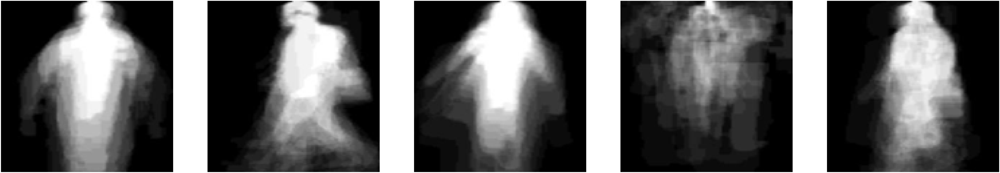

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
Use `tf.keras.layers.Conv2DTranspose` instead.
Instructions for updating:
Use keras.layers.BatchNormalization instead.  In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.BatchNormalization` documentation).
Instructions for updating:
Use `tf.keras.layers.Conv2D` instead.
Epoch 1/50 
Duration: 320.00641 
D Loss: 2.16590 
G Loss: 0.26483


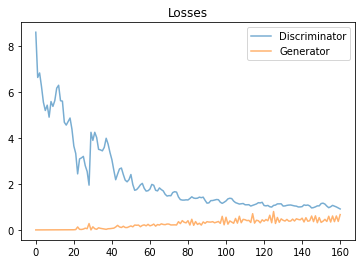

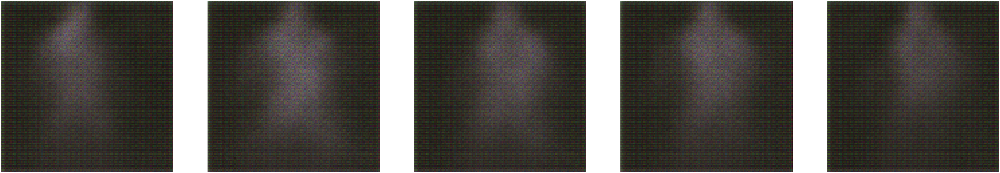

Epoch 2/50 
Duration: 313.96681 
D Loss: 0.88131 
G Loss: 0.57998


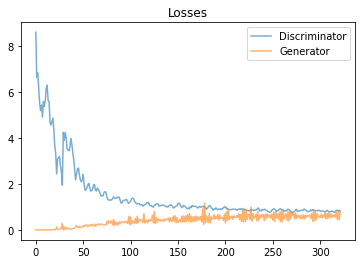

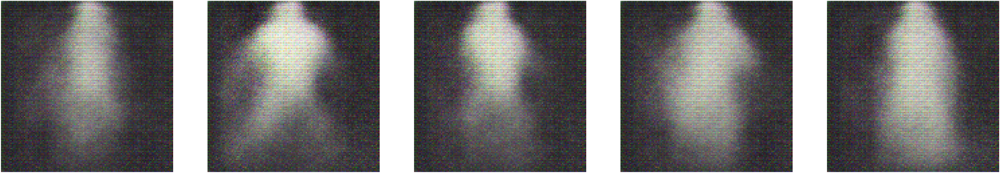

Epoch 3/50 
Duration: 315.07259 
D Loss: 0.79536 
G Loss: 0.63118


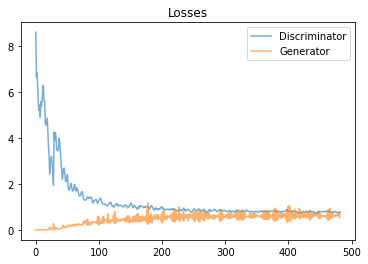

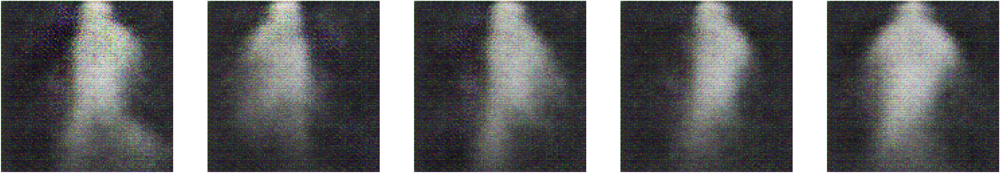

Epoch 4/50 
Duration: 315.25865 
D Loss: 0.77157 
G Loss: 0.65566


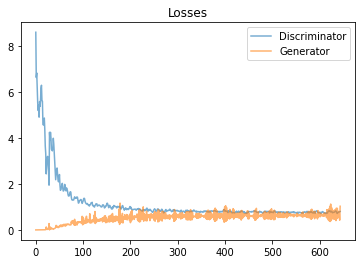

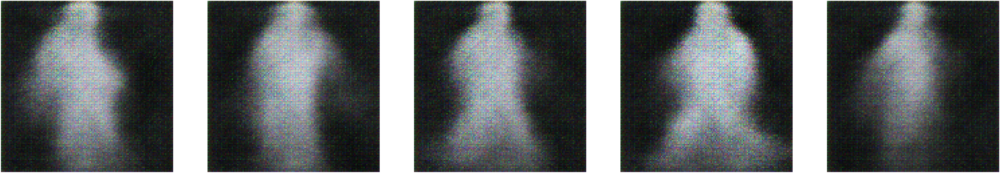

Epoch 5/50 
Duration: 315.23251 
D Loss: 0.74955 
G Loss: 0.67187


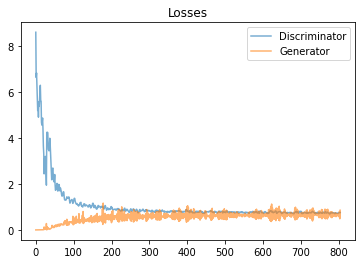

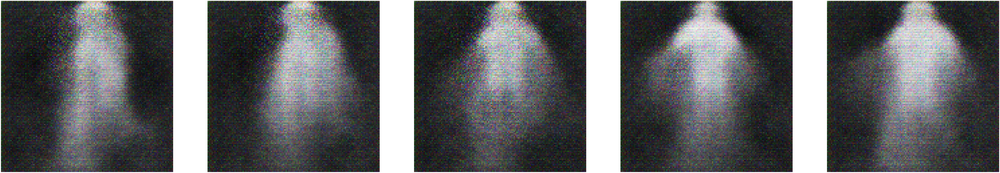

Epoch 6/50 
Duration: 314.78256 
D Loss: 0.74532 
G Loss: 0.67944


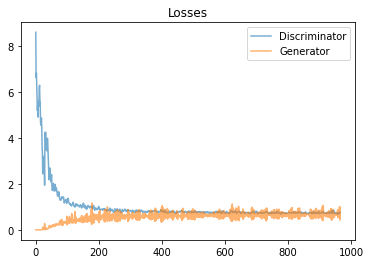

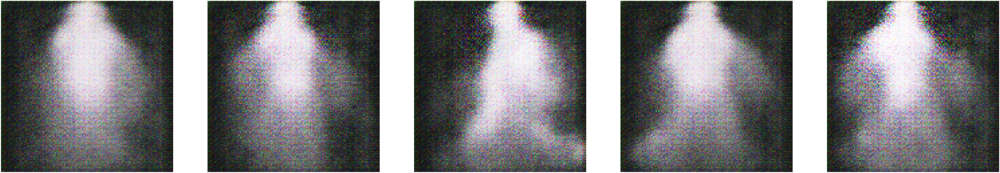

Epoch 7/50 
Duration: 313.69696 
D Loss: 0.73603 
G Loss: 0.68393


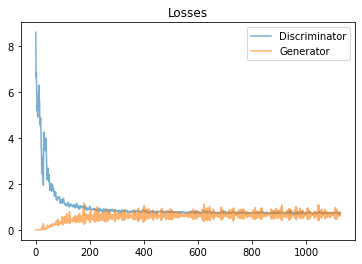

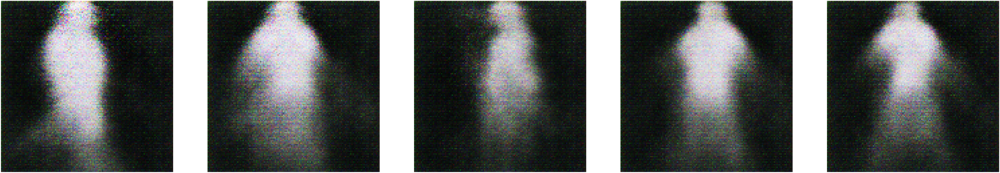

Epoch 8/50 
Duration: 315.53332 
D Loss: 0.73066 
G Loss: 0.68872


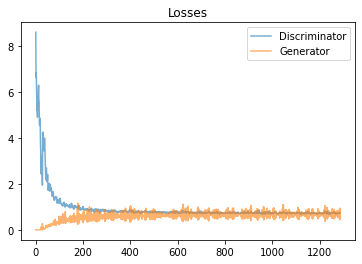

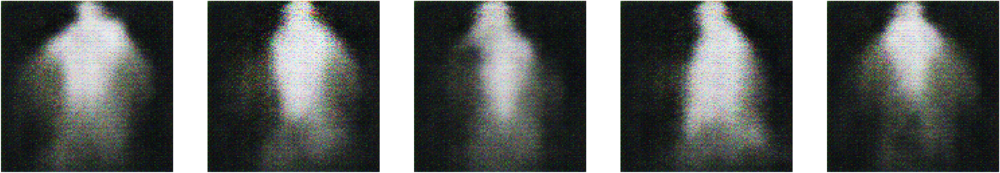

Epoch 9/50 
Duration: 314.65420 
D Loss: 0.72810 
G Loss: 0.69106


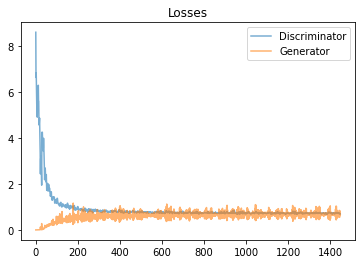

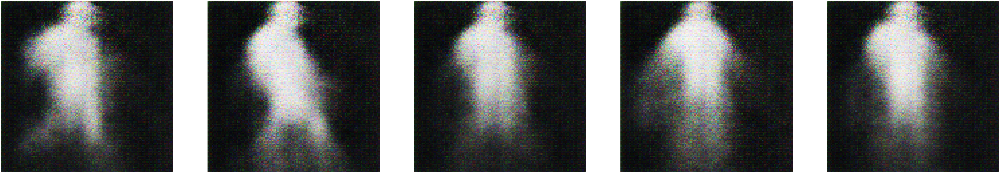

Epoch 10/50 
Duration: 315.68494 
D Loss: 0.72805 
G Loss: 0.69497


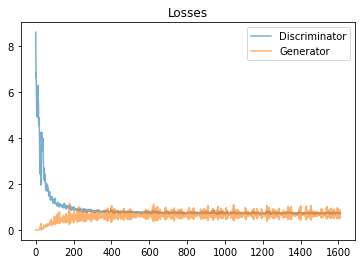

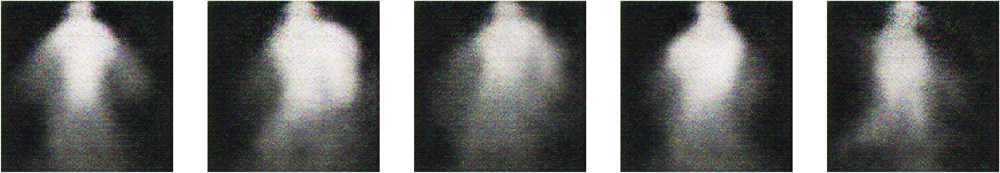

Epoch 11/50 
Duration: 315.18654 
D Loss: 0.72397 
G Loss: 0.69718


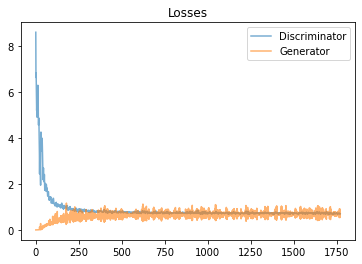

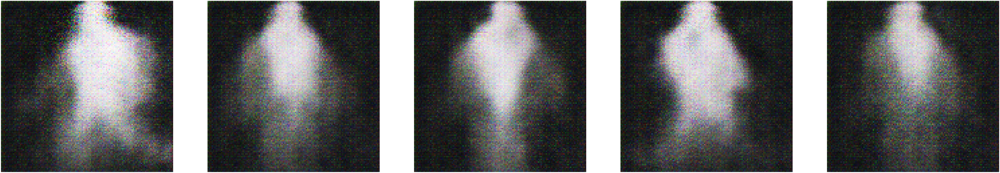

Epoch 12/50 
Duration: 315.43430 
D Loss: 0.72371 
G Loss: 0.69683


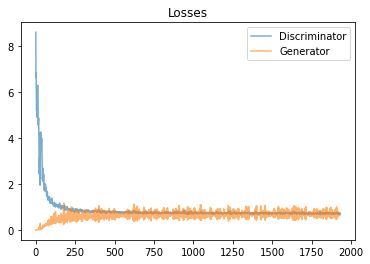

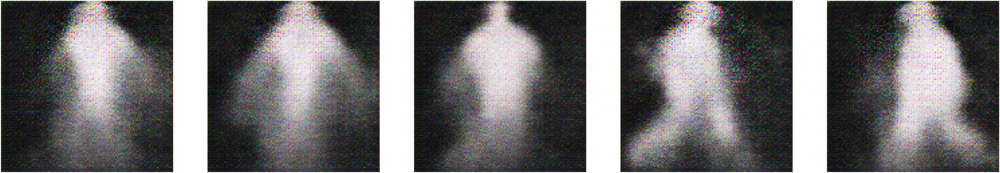

Epoch 13/50 
Duration: 314.70988 
D Loss: 0.72270 
G Loss: 0.69887


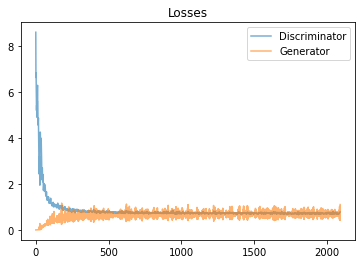

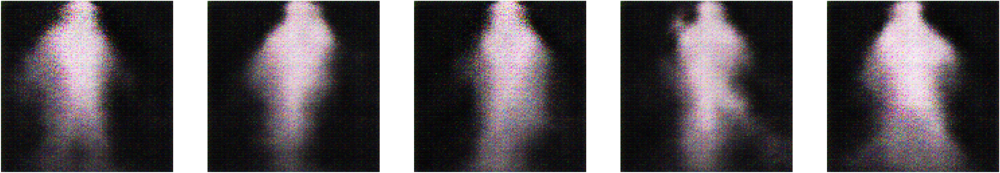

Epoch 14/50 
Duration: 315.34104 
D Loss: 0.71839 
G Loss: 0.69755


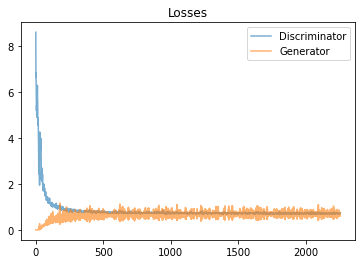

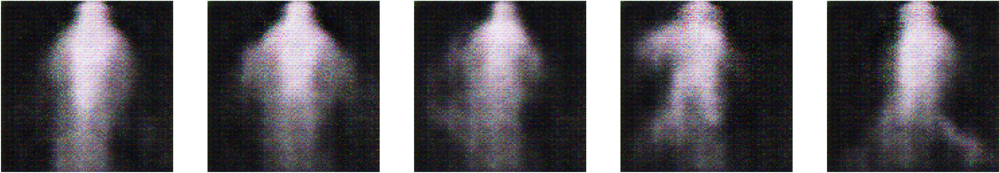

Epoch 15/50 
Duration: 315.11006 
D Loss: 0.71817 
G Loss: 0.70030


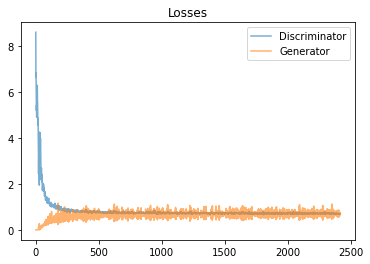

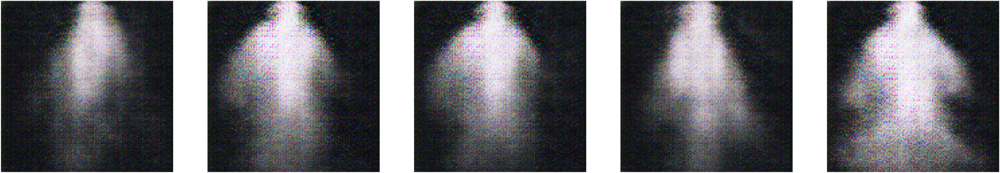

Epoch 16/50 
Duration: 315.18640 
D Loss: 0.71896 
G Loss: 0.70335


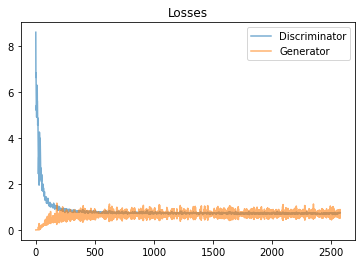

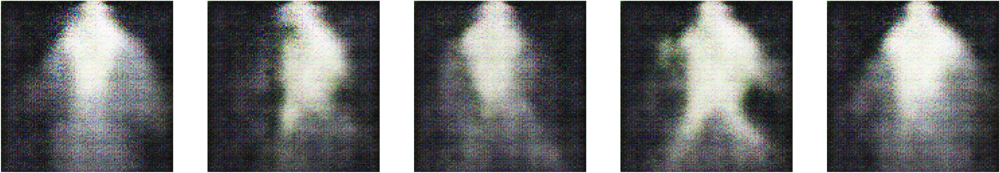

Epoch 17/50 
Duration: 315.19587 
D Loss: 0.71798 
G Loss: 0.70282


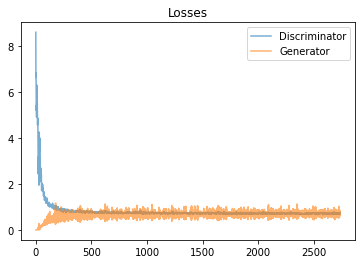

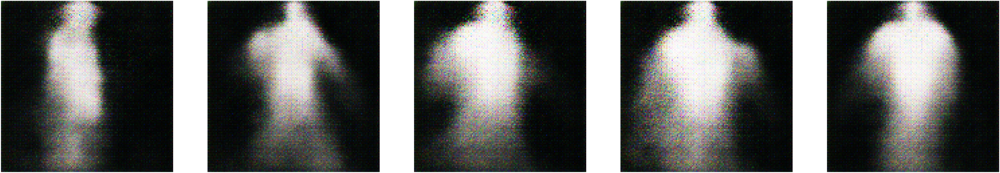

Epoch 18/50 
Duration: 315.22535 
D Loss: 0.71796 
G Loss: 0.69773


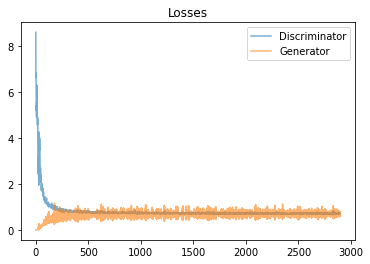

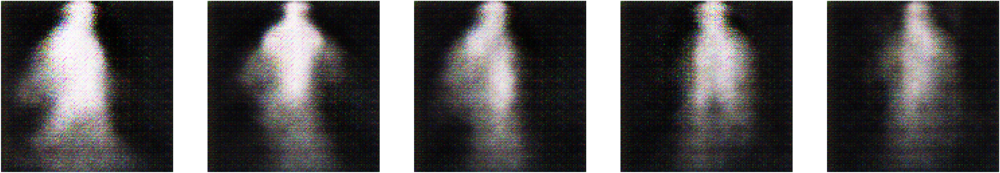

Epoch 19/50 
Duration: 315.22383 
D Loss: 0.71715 
G Loss: 0.70342


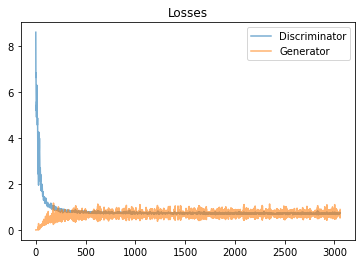

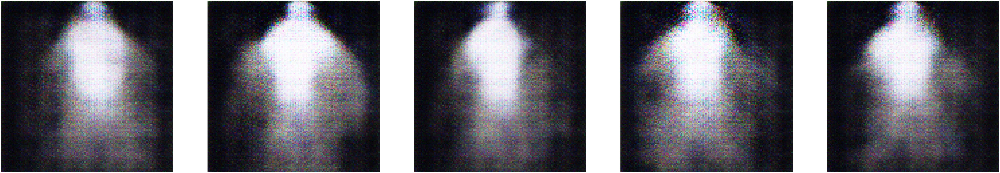

Epoch 20/50 
Duration: 315.21456 
D Loss: 0.71592 
G Loss: 0.70622


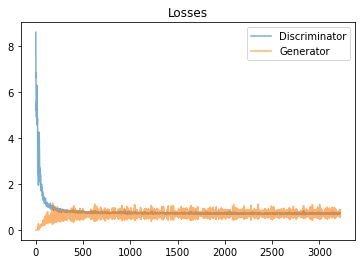

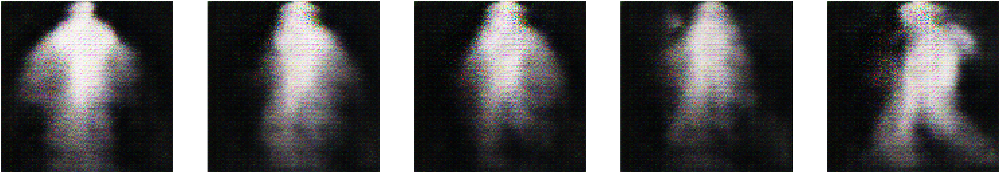

Epoch 21/50 
Duration: 315.36191 
D Loss: 0.71462 
G Loss: 0.70314


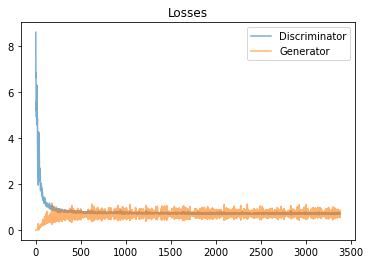

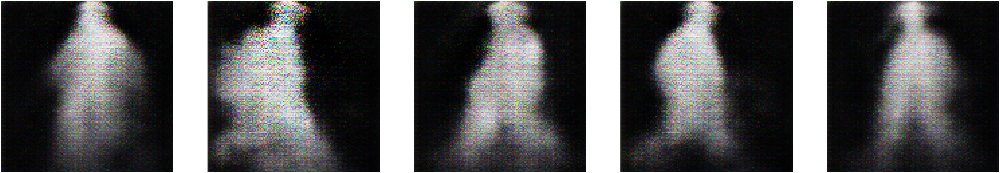

Epoch 22/50 
Duration: 315.53130 
D Loss: 0.71308 
G Loss: 0.70359


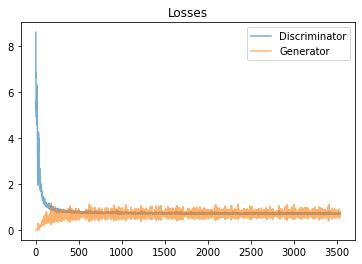

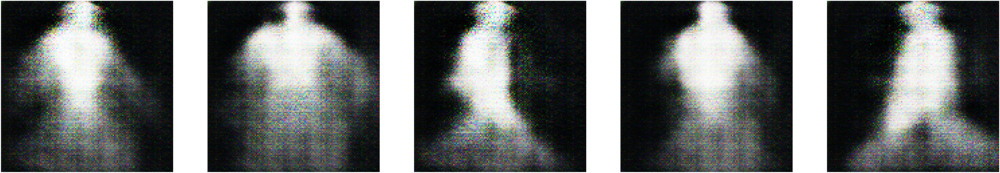

Epoch 23/50 
Duration: 314.68489 
D Loss: 0.71528 
G Loss: 0.70092


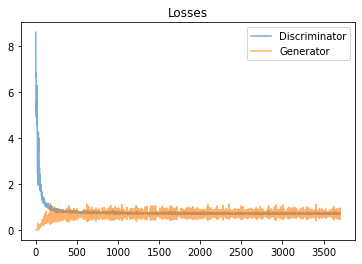

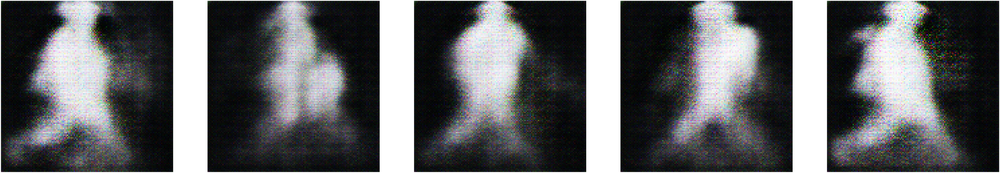

Epoch 24/50 
Duration: 314.59914 
D Loss: 0.71547 
G Loss: 0.70267


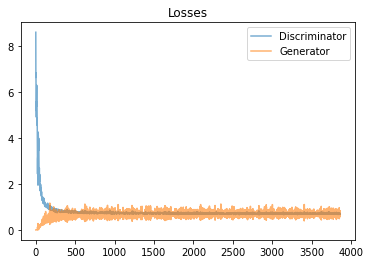

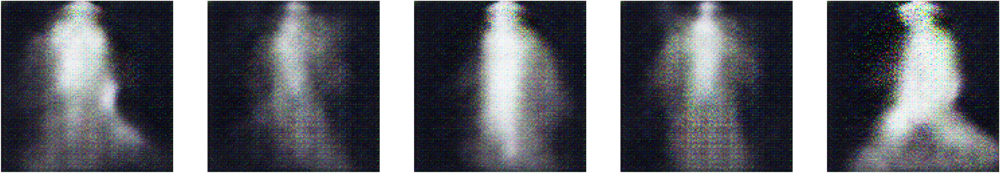

Epoch 25/50 
Duration: 314.82416 
D Loss: 0.71638 
G Loss: 0.70100


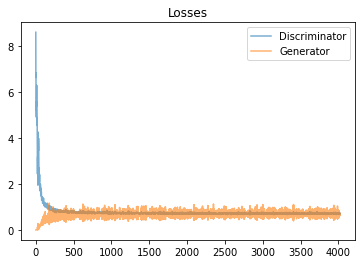

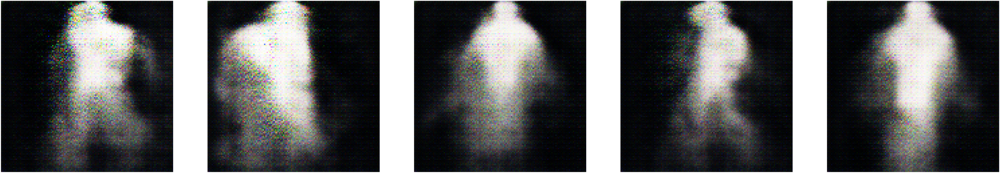

Epoch 26/50 
Duration: 314.71125 
D Loss: 0.71670 
G Loss: 0.69708


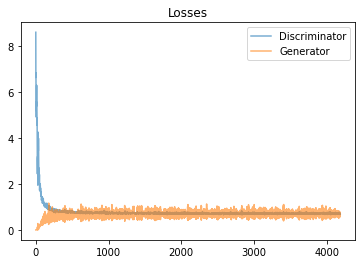

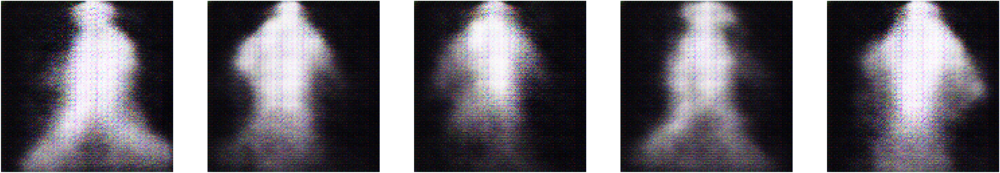

Epoch 27/50 
Duration: 315.54141 
D Loss: 0.71446 
G Loss: 0.70178


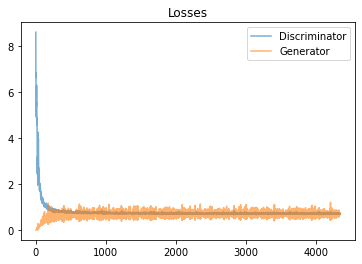

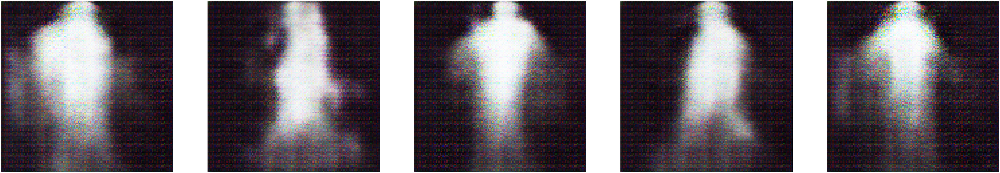

Epoch 28/50 
Duration: 314.93854 
D Loss: 0.71505 
G Loss: 0.70410


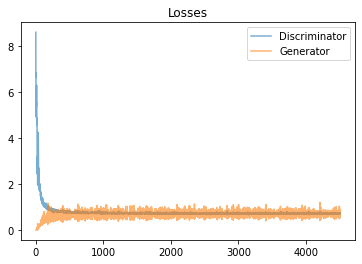

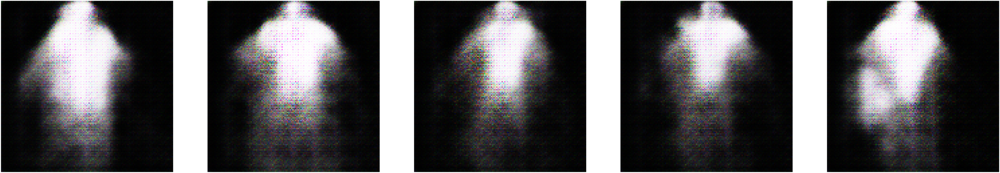

Epoch 29/50 
Duration: 315.00119 
D Loss: 0.71313 
G Loss: 0.70208


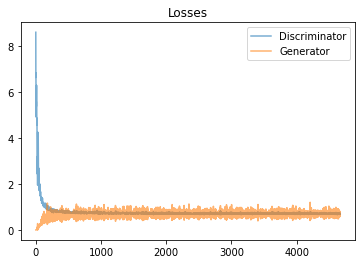

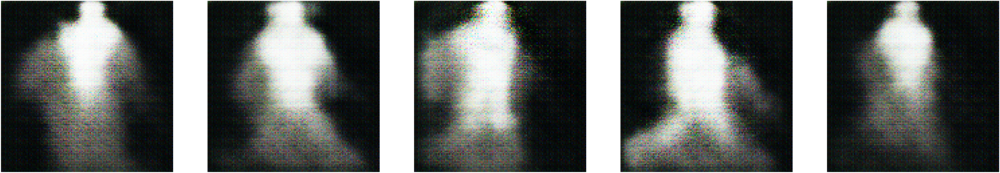

Epoch 30/50 
Duration: 314.18690 
D Loss: 0.71567 
G Loss: 0.69880


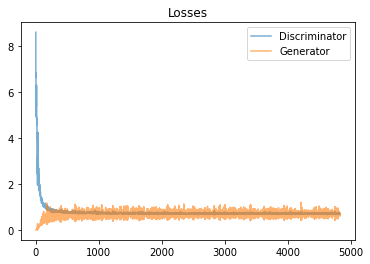

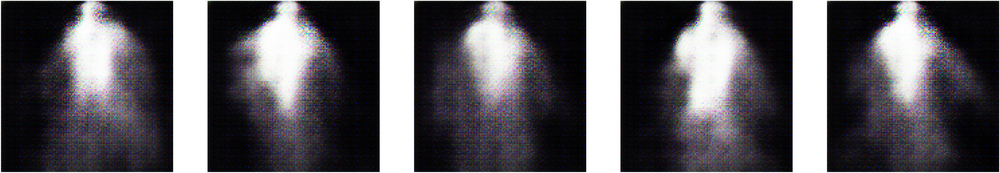

Epoch 31/50 
Duration: 314.07953 
D Loss: 0.71450 
G Loss: 0.70469


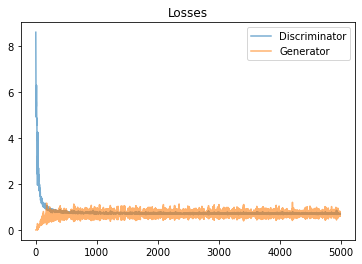

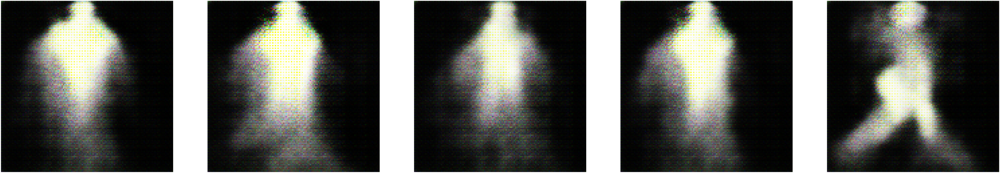

Epoch 32/50 
Duration: 315.25886 
D Loss: 0.71316 
G Loss: 0.70393


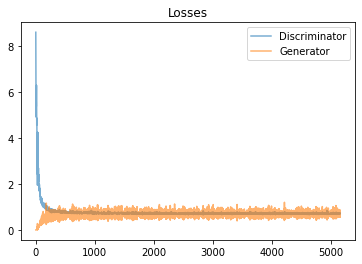

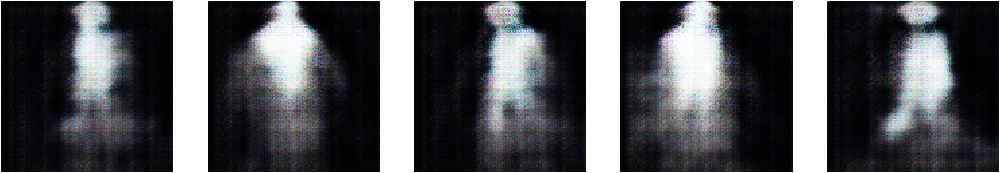

Epoch 33/50 
Duration: 315.13450 
D Loss: 0.71365 
G Loss: 0.70177


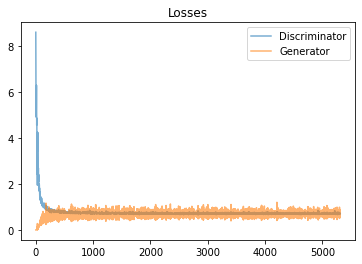

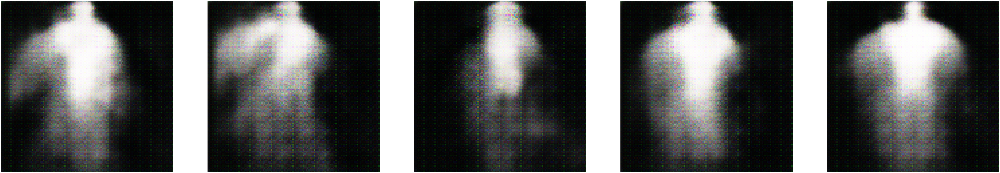

Epoch 34/50 
Duration: 315.36030 
D Loss: 0.71164 
G Loss: 0.70280


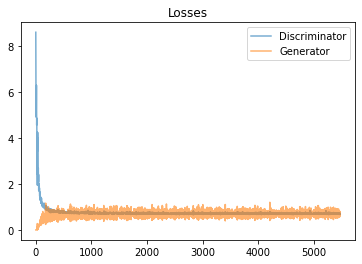

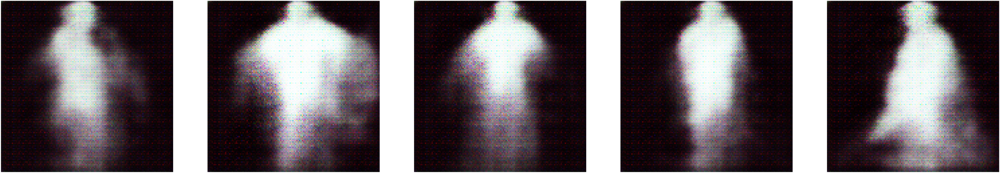

Epoch 35/50 
Duration: 315.20814 
D Loss: 0.71020 
G Loss: 0.70042


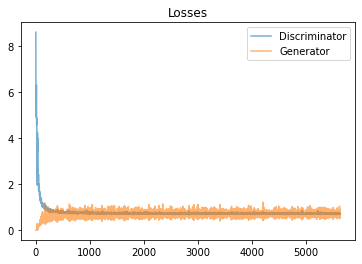

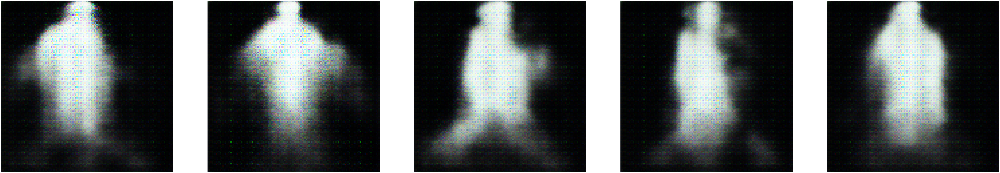

Epoch 36/50 
Duration: 315.74785 
D Loss: 0.70825 
G Loss: 0.70067


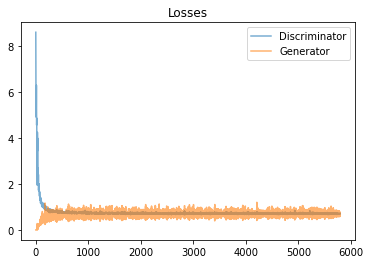

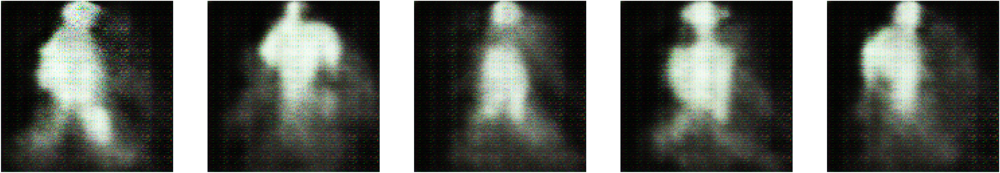

Epoch 37/50 
Duration: 315.35449 
D Loss: 0.71231 
G Loss: 0.70162


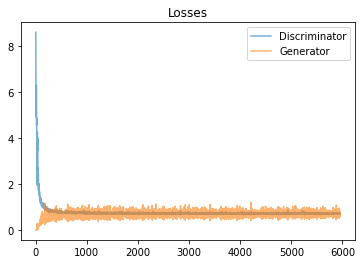

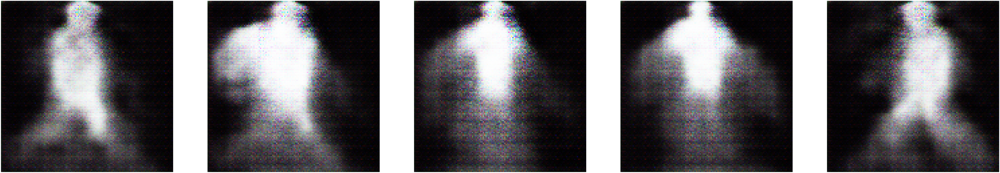

Epoch 38/50 
Duration: 314.29091 
D Loss: 0.70977 
G Loss: 0.70283


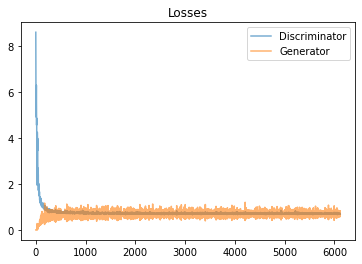

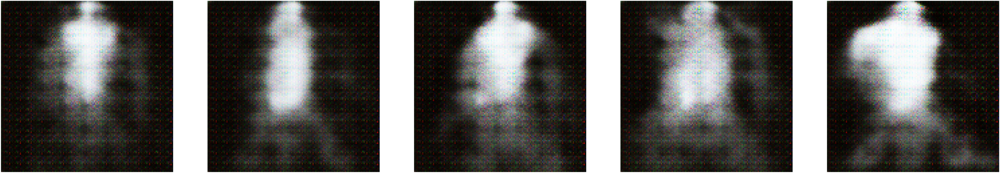

Epoch 39/50 
Duration: 314.73800 
D Loss: 0.71123 
G Loss: 0.70405


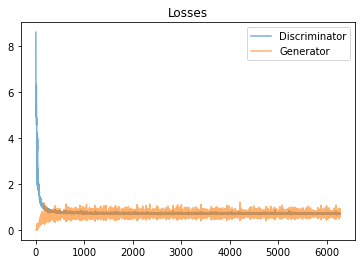

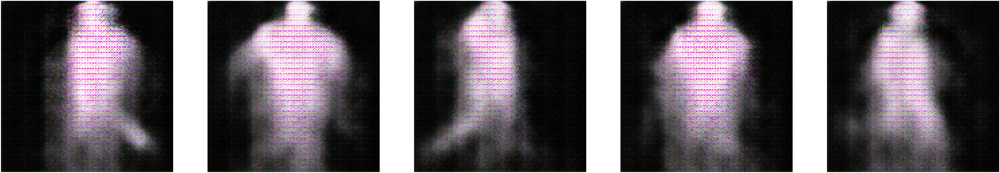

Epoch 40/50 
Duration: 314.75927 
D Loss: 0.70807 
G Loss: 0.70041


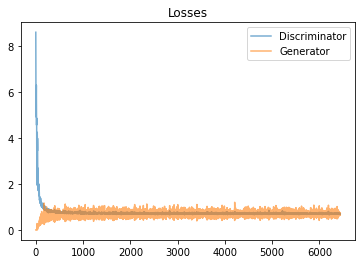

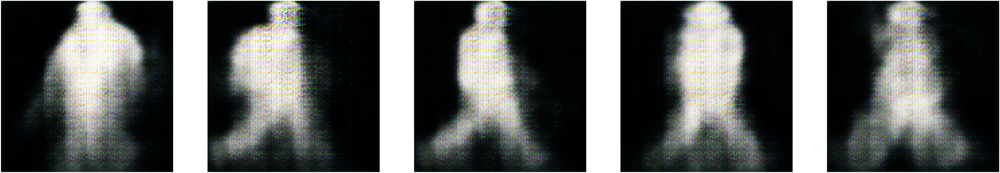

Epoch 41/50 
Duration: 314.89705 
D Loss: 0.70713 
G Loss: 0.70453


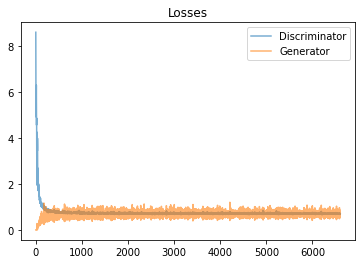

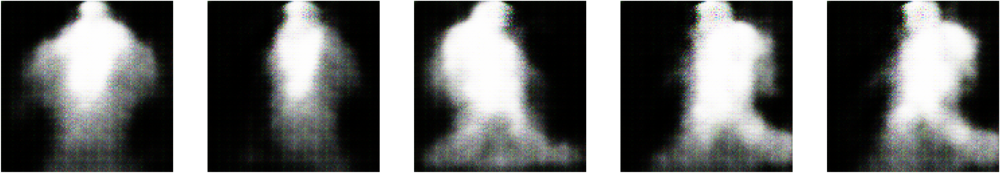

Epoch 42/50 
Duration: 315.11472 
D Loss: 0.70837 
G Loss: 0.70203


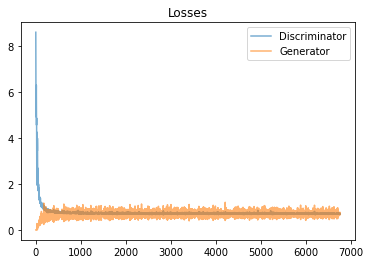

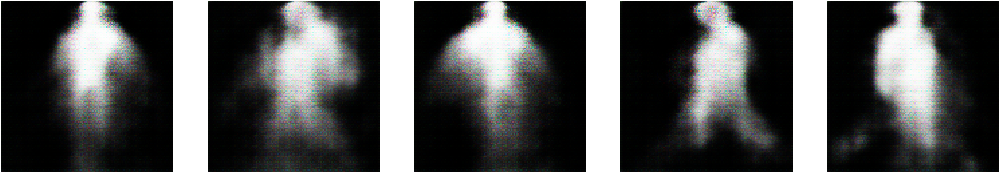

Epoch 43/50 
Duration: 315.26293 
D Loss: 0.71163 
G Loss: 0.70415


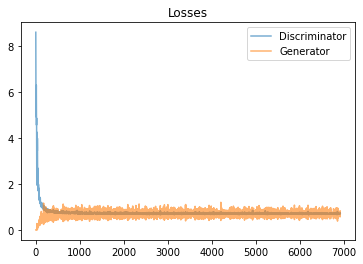

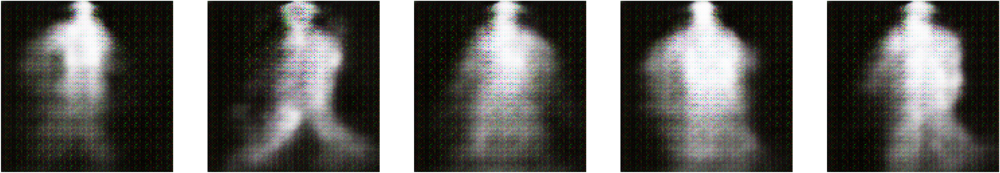

Epoch 44/50 
Duration: 314.66141 
D Loss: 0.70734 
G Loss: 0.70584


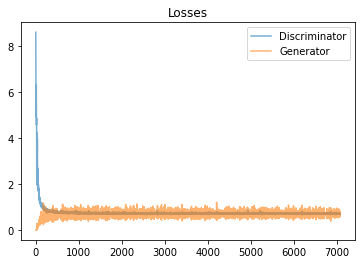

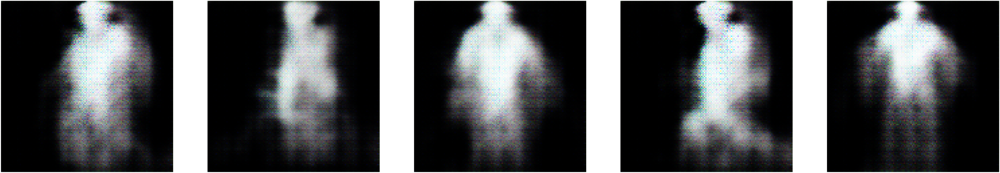

Epoch 45/50 
Duration: 314.42138 
D Loss: 0.70656 
G Loss: 0.70268


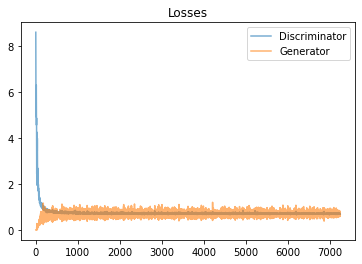

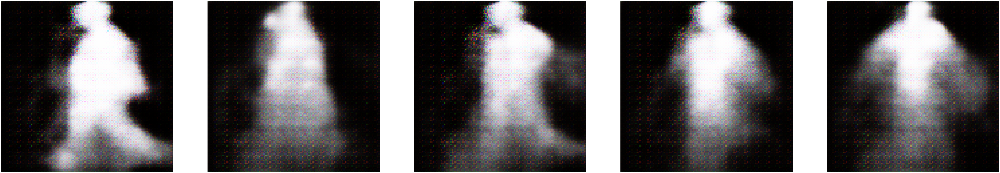

Epoch 46/50 
Duration: 314.28828 
D Loss: 0.70781 
G Loss: 0.70294


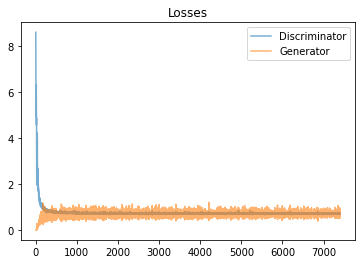

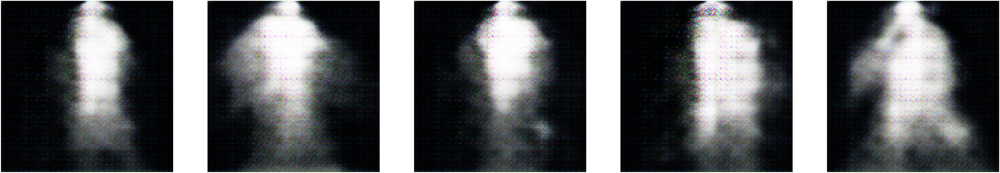

Epoch 47/50 
Duration: 314.68550 
D Loss: 0.70757 
G Loss: 0.70179


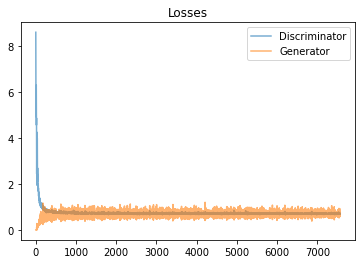

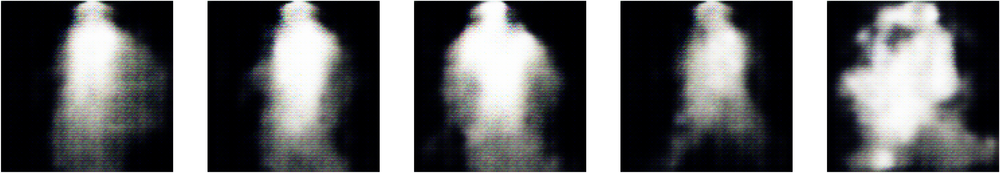

Epoch 48/50 
Duration: 314.32314 
D Loss: 0.70831 
G Loss: 0.70358


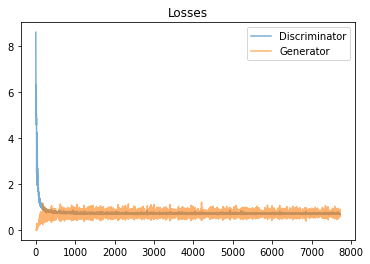

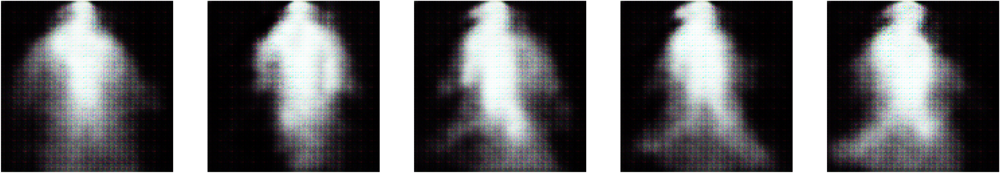

Epoch 49/50 
Duration: 314.94284 
D Loss: 0.70815 
G Loss: 0.70134


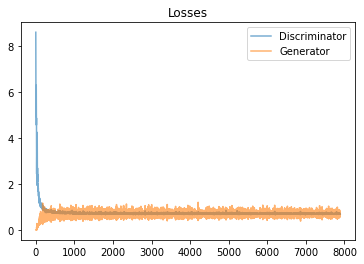

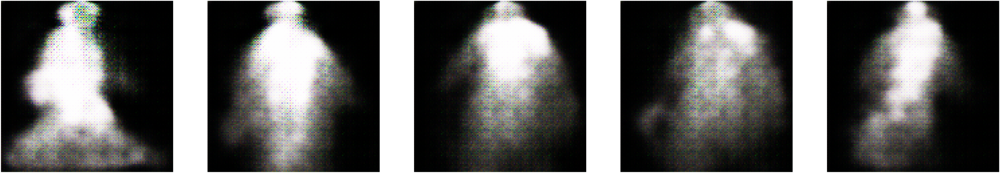

Epoch 50/50 
Duration: 315.47714 
D Loss: 0.70829 
G Loss: 0.70647


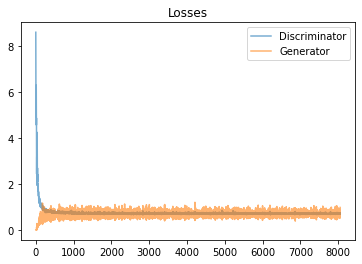

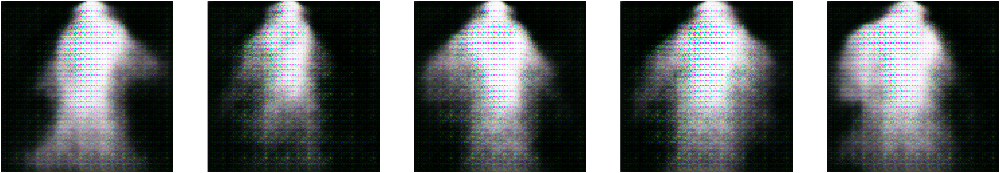

In [0]:
print("Start!")
input_images = np.asarray([np.asarray(Image.open(file).resize((IMAGE_SIZE, IMAGE_SIZE))) for file in glob(INPUT_DATA_DIR + '*')])
print ("Input: " + str(input_images.shape))

np.random.shuffle(input_images)

sample_images = random.sample(list(input_images), SAMPLES_TO_SHOW)
show_samples(sample_images, OUTPUT_DIR + "inputs", 0)

with tf.Graph().as_default():
    train(get_batches(input_images), input_images.shape)